<a href="https://colab.research.google.com/github/manaaryaman1977/Momentum-trading-algorithm/blob/main/Copy_of_Untitled7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install yfinance numpy pandas scipy

In [ ]:
!pip install arch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.3/981.3 kB 16.8 MB/s eta 0:00:00


In [ ]:
pip install nsetools

In [ ]:
pip install lxml

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
from scipy.stats import skew, kurtosis

In [ ]:
start_date = "2000-01-01"
end_date = "2025-09-30"

In [ ]:
import pandas as pd
import yfinance as yf
from datetime import datetime
import time
import warnings
warnings.filterwarnings('ignore')

# Current Nifty 50 stocks (as of October 2024)
CURRENT_NIFTY50 = [
    'ADANIENT.NS', 'ADANIPORTS.NS', 'APOLLOHOSP.NS', 'ASIANPAINT.NS', 'AXISBANK.NS',
    'BAJAJ-AUTO.NS', 'BAJFINANCE.NS', 'BAJAJFINSV.NS', 'BEL.NS', 'BPCL.NS',
    'BHARTIARTL.NS', 'BRITANNIA.NS', 'CIPLA.NS', 'COALINDIA.NS', 'DRREDDY.NS',
    'EICHERMOT.NS', 'GRASIM.NS', 'HCLTECH.NS', 'HDFCBANK.NS', 'HDFCLIFE.NS',
    'HEROMOTOCO.NS', 'HINDALCO.NS', 'HINDUNILVR.NS', 'ICICIBANK.NS', 'INDUSINDBK.NS',
    'INFY.NS', 'ITC.NS', 'JSWSTEEL.NS', 'KOTAKBANK.NS', 'LT.NS',
    'M&M.NS', 'MARUTI.NS', 'NESTLEIND.NS', 'NTPC.NS', 'ONGC.NS',
    'POWERGRID.NS', 'RELIANCE.NS', 'SBILIFE.NS', 'SHRIRAMFIN.NS', 'SBIN.NS',
    'SUNPHARMA.NS', 'TCS.NS', 'TATACONSUM.NS', 'TATAMOTORS.NS', 'TATASTEEL.NS',
    'TECHM.NS', 'TITAN.NS', 'ULTRACEMCO.NS', 'WIPRO.NS', 'ZOMATO.NS'
]

# Historical stocks that were in Nifty 50 but are no longer (2000-2024)
# This includes major removals due to mergers, delistings, or replacement
REMOVED_NIFTY50 = [
    'SATYAMCOMP.NS',  # Satyam (delisted after scandal)
    'RCOM.NS',  # Reliance Communications
    'YESBANK.NS',  # Yes Bank (removed, now in recovery)
    'CAIRN.NS',  # Cairn India (merged with Vedanta)
    'DLF.NS',  # DLF (removed)
    'IDEA.NS',  # Idea Cellular (merged to form Vodafone Idea)
    'ACC.NS',  # ACC (removed from Nifty 50)
    'BANKBARODA.NS',  # Bank of Baroda (removed)
    'BHEL.NS',  # BHEL (removed)
    'BOSCHLTD.NS',  # Bosch (removed)
    'GAIL.NS',  # GAIL (removed)
    'HDFC.NS',  # HDFC Ltd (merged with HDFC Bank in 2023)
    'HINDZINC.NS',  # Hindustan Zinc (removed)
    'NMDC.NS',  # NMDC (removed)
    'PNB.NS',  # Punjab National Bank (removed)
    'RANBAXY.NS',  # Ranbaxy (acquired by Sun Pharma)
    'RPOWER.NS',  # Reliance Power (removed)
    'SIEMENS.NS',  # Siemens (removed)
    'SAIL.NS',  # SAIL (removed)
    'SESA.NS',  # Sesa Goa (merged)
    'STER.NS',  # Sterlite Industries (merged)
    'TATAPOWER.NS',  # Tata Power (removed)
    'VEDL.NS',  # Vedanta (removed and re-added over years)
    'IDFC.NS',  # IDFC (removed)
    'INFRATEL.NS',  # Bharti Infratel (merged with Indus Towers)
    'ZEEL.NS',  # Zee Entertainment (removed)
]

def create_stock_master_list():
    """Create master list of all Nifty 50 stocks with current status"""

    all_stocks = {}

    # Add current Nifty 50 stocks
    for symbol in CURRENT_NIFTY50:
        all_stocks[symbol] = {
            'symbol': symbol,
            'company_name': symbol.replace('.NS', ''),
            'current_in_nifty50': True,
            'status': 'CURRENT'
        }

    # Add removed stocks
    for symbol in REMOVED_NIFTY50:
        all_stocks[symbol] = {
            'symbol': symbol,
            'company_name': symbol.replace('.NS', ''),
            'current_in_nifty50': False,
            'status': 'REMOVED'
        }

    return all_stocks

def fetch_stock_data(symbol, start_date='2000-01-01', end_date=None):
    """Fetch historical price data for a stock"""

    if end_date is None:
        end_date = datetime.now().strftime('%Y-%m-%d')

    try:
        print(f"Fetching data for {symbol}...")
        stock = yf.Ticker(symbol)
        df = stock.history(start=start_date, end=end_date)

        if df.empty:
            print(f"  ⚠️  No data available for {symbol}")
            return None

        # Reset index to make Date a column
        df.reset_index(inplace=True)
        df['Symbol'] = symbol

        print(f"  ✓ Fetched {len(df)} records for {symbol}")
        return df

    except Exception as e:
        print(f"  ✗ Error fetching {symbol}: {str(e)}")
        return None

def fetch_all_nifty50_data(start_date='2000-01-01'):
    """Fetch data for all Nifty 50 stocks (current and historical)"""

    print("=" * 70)
    print("NIFTY 50 HISTORICAL DATA FETCHER")
    print("=" * 70)
    print(f"Start Date: {start_date}")
    print(f"End Date: {datetime.now().strftime('%Y-%m-%d')}")
    print("=" * 70)

    stock_master = create_stock_master_list()
    all_data = []

    total_stocks = len(stock_master)
    successful = 0
    failed = 0

    for idx, (symbol, info) in enumerate(stock_master.items(), 1):
        print(f"\n[{idx}/{total_stocks}] Processing {symbol} ({info['status']})")

        df = fetch_stock_data(symbol, start_date)

        if df is not None:
            # Add metadata
            df['Current_In_Nifty50'] = info['current_in_nifty50']
            df['Status'] = info['status']
            df['Company_Name'] = info['company_name']

            all_data.append(df)
            successful += 1
        else:
            failed += 1

        # Rate limiting to avoid being blocked
        time.sleep(0.5)

    print("\n" + "=" * 70)
    print("FETCH SUMMARY")
    print("=" * 70)
    print(f"Total stocks: {total_stocks}")
    print(f"Successfully fetched: {successful}")
    print(f"Failed: {failed}")
    print("=" * 70)

    if all_data:
        # Combine all dataframes
        combined_df = pd.concat(all_data, ignore_index=True)
        return combined_df, stock_master
    else:
        return None, stock_master

def save_data(df, stock_master, output_prefix='nifty50'):
    """Save the data to CSV files"""

    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')

    # Save complete price data
    price_file = f'{output_prefix}_prices_{timestamp}.csv'
    df.to_csv(price_file, index=False)
    print(f"\n✓ Saved price data to: {price_file}")

    # Save stock master list
    master_df = pd.DataFrame.from_dict(stock_master, orient='index')
    master_file = f'{output_prefix}_master_list_{timestamp}.csv'
    master_df.to_csv(master_file, index=False)
    print(f"✓ Saved master list to: {master_file}")

    # Create summary statistics
    summary = {
        'Total Stocks': len(stock_master),
        'Current Nifty 50': len(CURRENT_NIFTY50),
        'Removed Stocks': len(REMOVED_NIFTY50),
        'Total Price Records': len(df),
        'Date Range': f"{df['Date'].min()} to {df['Date'].max()}"
    }

    summary_df = pd.DataFrame([summary])
    summary_file = f'{output_prefix}_summary_{timestamp}.csv'
    summary_df.to_csv(summary_file, index=False)
    print(f"✓ Saved summary to: {summary_file}")

    return price_file, master_file, summary_file

def analyze_data(df):
    """Provide basic analysis of the fetched data"""

    print("\n" + "=" * 70)
    print("DATA ANALYSIS")
    print("=" * 70)

    # Stocks by status
    print("\n📊 Stocks by Status:")
    status_counts = df.groupby('Status')['Symbol'].nunique()
    for status, count in status_counts.items():
        print(f"  {status}: {count} stocks")

    # Date range by stock
    print("\n📅 Data Availability:")
    date_range = df.groupby('Symbol')['Date'].agg(['min', 'max', 'count'])
    print(f"  Average records per stock: {date_range['count'].mean():.0f}")
    print(f"  Earliest data: {df['Date'].min()}")
    print(f"  Latest data: {df['Date'].max()}")

    # Stocks with complete data from 2000
    try:
        early_cutoff = pd.Timestamp('2001-01-01')
        early_stocks = date_range[date_range['min'] < early_cutoff]
        print(f"\n  Stocks with data from 2000-2001: {len(early_stocks)}")
    except:
        print(f"\n  Stocks with early data available: {len(date_range)}")

    print("=" * 70)

def main():
    """Main execution function"""

    print("\n🚀 Starting Nifty 50 Historical Data Collection...")
    print("This will fetch data from 2000 to today for all Nifty 50 constituents.\n")

    # Fetch all data
    df, stock_master = fetch_all_nifty50_data(start_date='2000-01-01')

    if df is not None:
        # Analyze the data
        analyze_data(df)

        # Save to files
        print("\n💾 Saving data to CSV files...")
        price_file, master_file, summary_file = save_data(df, stock_master)

        print("\n" + "=" * 70)
        print("✅ DATA COLLECTION COMPLETE!")
        print("=" * 70)
        print("\nYou now have:")
        print(f"1. {price_file} - All historical prices with Nifty 50 status")
        print(f"2. {master_file} - Master list of all stocks")
        print(f"3. {summary_file} - Summary statistics")
        print("\nYou can now:")
        print("- Filter by 'Current_In_Nifty50' column (True/False)")
        print("- Separate current vs removed stocks")
        print("- Analyze performance of stocks that left the index")
        print("=" * 70)

    else:
        print("\n❌ Failed to fetch data. Please check your internet connection and try again.")

if __name__ == "__main__":
    main()


🚀 Starting Nifty 50 Historical Data Collection...
This will fetch data from 2000 to today for all Nifty 50 constituents.

NIFTY 50 HISTORICAL DATA FETCHER
Start Date: 2000-01-01
End Date: 2025-10-28

[1/76] Processing ADANIENT.NS (CURRENT)
Fetching data for ADANIENT.NS...
  ✓ Fetched 5792 records for ADANIENT.NS

[2/76] Processing ADANIPORTS.NS (CURRENT)
Fetching data for ADANIPORTS.NS...
  ✓ Fetched 4416 records for ADANIPORTS.NS

[3/76] Processing APOLLOHOSP.NS (CURRENT)
Fetching data for APOLLOHOSP.NS...
  ✓ Fetched 5790 records for APOLLOHOSP.NS

[4/76] Processing ASIANPAINT.NS (CURRENT)
Fetching data for ASIANPAINT.NS...
  ✓ Fetched 5790 records for ASIANPAINT.NS

[5/76] Processing AXISBANK.NS (CURRENT)
Fetching data for AXISBANK.NS...
  ✓ Fetched 6440 records for AXISBANK.NS

[6/76] Processing BAJAJ-AUTO.NS (CURRENT)
Fetching data for BAJAJ-AUTO.NS...
  ✓ Fetched 5793 records for BAJAJ-AUTO.NS

[7/76] Processing BAJFINANCE.NS (CURRENT)
Fetching data for BAJFINANCE.NS...
  ✓ Fetc

ERROR:yfinance:$ZOMATO.NS: possibly delisted; no timezone found



[50/76] Processing ZOMATO.NS (CURRENT)
Fetching data for ZOMATO.NS...
  ⚠️  No data available for ZOMATO.NS

[51/76] Processing SATYAMCOMP.NS (REMOVED)
Fetching data for SATYAMCOMP.NS...


ERROR:yfinance:$SATYAMCOMP.NS: possibly delisted; no timezone found


  ⚠️  No data available for SATYAMCOMP.NS

[52/76] Processing RCOM.NS (REMOVED)
Fetching data for RCOM.NS...
  ✓ Fetched 5759 records for RCOM.NS

[53/76] Processing YESBANK.NS (REMOVED)
Fetching data for YESBANK.NS...
  ✓ Fetched 5006 records for YESBANK.NS


ERROR:yfinance:$CAIRN.NS: possibly delisted; no price data found  (1d 2000-01-01 -> 2025-10-28)



[54/76] Processing CAIRN.NS (REMOVED)
Fetching data for CAIRN.NS...
  ⚠️  No data available for CAIRN.NS

[55/76] Processing DLF.NS (REMOVED)
Fetching data for DLF.NS...
  ✓ Fetched 4516 records for DLF.NS

[56/76] Processing IDEA.NS (REMOVED)
Fetching data for IDEA.NS...
  ✓ Fetched 4596 records for IDEA.NS

[57/76] Processing ACC.NS (REMOVED)
Fetching data for ACC.NS...
  ✓ Fetched 5790 records for ACC.NS

[58/76] Processing BANKBARODA.NS (REMOVED)
Fetching data for BANKBARODA.NS...
  ✓ Fetched 5790 records for BANKBARODA.NS

[59/76] Processing BHEL.NS (REMOVED)
Fetching data for BHEL.NS...
  ✓ Fetched 6440 records for BHEL.NS

[60/76] Processing BOSCHLTD.NS (REMOVED)
Fetching data for BOSCHLTD.NS...
  ✓ Fetched 5792 records for BOSCHLTD.NS

[61/76] Processing GAIL.NS (REMOVED)
Fetching data for GAIL.NS...
  ✓ Fetched 6440 records for GAIL.NS

[62/76] Processing HDFC.NS (REMOVED)
Fetching data for HDFC.NS...


ERROR:yfinance:$HDFC.NS: possibly delisted; no timezone found


  ⚠️  No data available for HDFC.NS

[63/76] Processing HINDZINC.NS (REMOVED)
Fetching data for HINDZINC.NS...
  ✓ Fetched 5763 records for HINDZINC.NS

[64/76] Processing NMDC.NS (REMOVED)
Fetching data for NMDC.NS...
  ✓ Fetched 4349 records for NMDC.NS

[65/76] Processing PNB.NS (REMOVED)
Fetching data for PNB.NS...
  ✓ Fetched 5792 records for PNB.NS


ERROR:yfinance:$RANBAXY.NS: possibly delisted; no price data found  (1d 2000-01-01 -> 2025-10-28)



[66/76] Processing RANBAXY.NS (REMOVED)
Fetching data for RANBAXY.NS...
  ⚠️  No data available for RANBAXY.NS

[67/76] Processing RPOWER.NS (REMOVED)
Fetching data for RPOWER.NS...
  ✓ Fetched 4364 records for RPOWER.NS

[68/76] Processing SIEMENS.NS (REMOVED)
Fetching data for SIEMENS.NS...
  ✓ Fetched 6443 records for SIEMENS.NS

[69/76] Processing SAIL.NS (REMOVED)
Fetching data for SAIL.NS...
  ✓ Fetched 6443 records for SAIL.NS


ERROR:yfinance:$SESA.NS: possibly delisted; no price data found  (1d 2000-01-01 -> 2025-10-28)



[70/76] Processing SESA.NS (REMOVED)
Fetching data for SESA.NS...
  ⚠️  No data available for SESA.NS

[71/76] Processing STER.NS (REMOVED)
Fetching data for STER.NS...
  ✓ Fetched 1784 records for STER.NS

[72/76] Processing TATAPOWER.NS (REMOVED)
Fetching data for TATAPOWER.NS...
  ✓ Fetched 6440 records for TATAPOWER.NS

[73/76] Processing VEDL.NS (REMOVED)
Fetching data for VEDL.NS...
  ✓ Fetched 6443 records for VEDL.NS

[74/76] Processing IDFC.NS (REMOVED)
Fetching data for IDFC.NS...


ERROR:yfinance:$IDFC.NS: possibly delisted; no timezone found


  ⚠️  No data available for IDFC.NS

[75/76] Processing INFRATEL.NS (REMOVED)
Fetching data for INFRATEL.NS...


ERROR:yfinance:$INFRATEL.NS: possibly delisted; no timezone found


  ⚠️  No data available for INFRATEL.NS

[76/76] Processing ZEEL.NS (REMOVED)
Fetching data for ZEEL.NS...
  ✓ Fetched 5790 records for ZEEL.NS

FETCH SUMMARY
Total stocks: 76
Successfully fetched: 68
Failed: 8

DATA ANALYSIS

📊 Stocks by Status:
  CURRENT: 49 stocks
  REMOVED: 19 stocks

📅 Data Availability:
  Average records per stock: 5686
  Earliest data: 2000-01-03 00:00:00+05:30
  Latest data: 2025-10-27 00:00:00+05:30

  Stocks with early data available: 68

💾 Saving data to CSV files...

✓ Saved price data to: nifty50_prices_20251028_134102.csv
✓ Saved master list to: nifty50_master_list_20251028_134102.csv
✓ Saved summary to: nifty50_summary_20251028_134102.csv

✅ DATA COLLECTION COMPLETE!

You now have:
1. nifty50_prices_20251028_134102.csv - All historical prices with Nifty 50 status
2. nifty50_master_list_20251028_134102.csv - Master list of all stocks
3. nifty50_summary_20251028_134102.csv - Summary statistics

You can now:
- Filter by 'Current_In_Nifty50' column (True/Fal

In [ ]:
import yfinance as yf
start_date="2000-01-01"
end_date="2025-12-31"
data = yf.download(nifty50_tickers, start=start_date, end=end_date)['Close']

NameError: name 'nifty50_tickers' is not defined

In [ ]:
import io, requests, time
import pandas as pd
import numpy as np
import yfinance as yf
from scipy.stats import skew, kurtosis

In [ ]:
# Upload xlsx
from google.colab import files
uploaded = files.upload()  # choose your .xlsx file

# Load and prepare data
import pandas as pd
import numpy as np
from scipy.stats import skew, kurtosis
import matplotlib.pyplot as plt
import os

fname = list(uploaded.keys())[0]
df = pd.read_excel(fname)

# normalize column names
df.columns = [c.strip() for c in df.columns]

# Required columns: Date, Close, Symbol, Current_In_Nifty50
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df = df.dropna(subset=['Date', 'Close', 'Symbol'])
df['Close'] = pd.to_numeric(df['Close'], errors='coerce')
df = df.dropna(subset=['Close'])

# Normalize symbol strings (ensure .NS if missing)
df['Symbol'] = df['Symbol'].astype(str).str.strip()
df['Symbol'] = df['Symbol'].apply(lambda s: s if s.endswith('.NS') else s + '.NS')

# Find the flag column (Current_In_Nifty50) robustly
if 'Current_In_Nifty50' in df.columns:
    col = 'Current_In_Nifty50'
else:
    col_candidates = [c for c in df.columns if 'nifty' in c.lower()]
    col = col_candidates[0] if col_candidates else None
if col is None:
    raise ValueError("Could not find the 'Current_In_Nifty50' column. Rename it to that or update the code.")

# Standardize flag values
df[col] = df[col].astype(str).str.strip().str.upper().map({
    'TRUE': True, 'FALSE': False, '1': True, '0': False, 'YES': True, 'NO': False
})
df[col] = df[col].fillna(False)

# Build price and flag pivot tables
price_df = df.pivot_table(index='Date', columns='Symbol', values='Close', aggfunc='last').sort_index()
flag_df  = df.pivot_table(index='Date', columns='Symbol', values=col, aggfunc='last').sort_index()

# Align indices (union of dates) and fill missing flags with False
all_idx = price_df.index.union(flag_df.index).sort_values()
price_df = price_df.reindex(all_idx)
flag_df  = flag_df.reindex(all_idx).fillna(False)

# Work with tickers present in both
tickers = sorted(set(price_df.columns).intersection(set(flag_df.columns)))
price_df = price_df[tickers]
flag_df  = flag_df[tickers]


Saving DFSHDFS.xlsx to DFSHDFS.xlsx


/tmp/ipython-input-2128181195.py:19: FutureWarning: In a future version of pandas, parsing datetimes with mixed time zones will raise an error unless `utc=True`. Please specify `utc=True` to opt in to the new behaviour and silence this warning. To create a `Series` with mixed offsets and `object` dtype, please use `apply` and `datetime.datetime.strptime`
  df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
/tmp/ipython-input-2128181195.py:50: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  flag_df  = flag_df.reindex(all_idx).fillna(False)


In [ ]:
# Strategy parameters
N = 20
alpha = (N - 1)/N
threshold = 0.5

pnl_dict = {}
stats = {}

# Prepare output folder for plots
outdir = "/content/pnl_plots"
os.makedirs(outdir, exist_ok=True)

for ticker in price_df.columns:
    price = price_df[ticker].dropna()
    if price.empty:
        continue

    # Align flag to price index (no phi masking here)
    f = flag_df[ticker].reindex(price.index).fillna(False).astype(bool)

    ret = price.diff()
    sigma = ret.rolling(30).std()
    U = ret / sigma

    # clip extremes
    lower = U.quantile(0.01)
    upper = U.quantile(0.99)
    U = U.clip(lower=lower, upper=upper)

    # compute EWMA phi across entire series (even when not in nifty)
    phi_unf = U.ewm(alpha=alpha, adjust=False).mean()
    phi_filtered = phi_unf.where(np.abs(phi_unf) >= threshold, 0.0)

    # compute raw pnl and force it to zero when flag is False
    raw_pnl = phi_filtered * U.shift(-1)
    pnl = raw_pnl.where(f, 0.0)  # <-- THIS ensures pnl is 0 when not in nifty

    # store series (including its datetime index)
    pnl_dict[ticker] = pnl

    # compute stats on pnl (dropna to ignore NaN from edges)
    s = pnl.dropna()
    stats[ticker] = {
        'Mean': s.mean() if not s.empty else np.nan,
        'Variance': s.var() if not s.empty else np.nan,
        'Skewness': skew(s) if not s.empty else np.nan,
        'Kurtosis': kurtosis(s) if not s.empty else np.nan,
    }


In [ ]:
# Convert to DataFrames and display summary
pnl_df = pd.DataFrame(pnl_dict)
stats_df = pd.DataFrame(stats).T

print("Date range used:", price_df.index.min(), "to", price_df.index.max())
print("Tickers used:", len(tickers))
print(stats_df.sort_values("Mean", ascending=True).head(50))

Date range used: 2000-01-03 00:00:00+05:30 to 2025-10-27 00:00:00+05:30
Tickers used: 68
                   Mean  Variance   Skewness     Kurtosis
POWERGRID.NS  -0.032271  1.014058   0.200019     8.623059
JSWSTEEL.NS   -0.019889  0.281151  -0.608410    32.636925
NTPC.NS       -0.018924  0.956365   0.431213     8.761513
BHARTIARTL.NS -0.016539  0.958192   0.341111    11.799032
CIPLA.NS      -0.012122  1.002856  -0.054691    10.940522
HDFCLIFE.NS   -0.012102  0.596868  -0.514751    13.102442
KOTAKBANK.NS  -0.011408  0.550692   0.329284    18.275454
GAIL.NS       -0.009732  0.466481   0.050711    21.454239
ITC.NS        -0.007747  0.949771   0.087527     8.933045
SBILIFE.NS    -0.007678  0.677954   0.697314    18.462345
SUNPHARMA.NS  -0.006957  1.030127   0.163170    11.279040
TATACONSUM.NS -0.006785  0.159255   0.792088    89.436288
ZEEL.NS       -0.004889  0.263818   0.346989    40.231830
NESTLEIND.NS  -0.004591  0.273960   0.415034    45.850697
HCLTECH.NS    -0.003631  0.959249   0.439

In [ ]:
# ---------- Compute 20-day rolling correlation: stock returns vs daily PnL ----------
corr_summary = {}

window = 20  # 20-day rolling window

for ticker in price_df.columns:
    price = price_df[ticker].dropna()
    pnl = pnl_dict.get(ticker)

    if price.empty or pnl is None:
        continue

    # Align both series
    df_temp = pd.concat([price, pnl], axis=1)
    df_temp.columns = ['price', 'pnl']
    df_temp = df_temp.dropna()

    # Compute daily returns (same method as your strategy)
    df_temp['ret'] = df_temp['price'].diff()
    df_temp = df_temp.dropna()

    # Rolling correlation between daily return and pnl
    df_temp['rolling_corr'] = df_temp['ret'].rolling(window).corr(df_temp['pnl'])

    # Store mean and last correlation
    mean_corr = df_temp['rolling_corr'].mean()
    last_corr = df_temp['rolling_corr'].iloc[-1] if not df_temp['rolling_corr'].empty else np.nan

    corr_summary[ticker] = {
        'Mean_20day_Corr': round(mean_corr, 4),
        'Last_20day_Corr': round(last_corr, 4)
    }

    # --- Optional: plot the rolling correlation line ---
    plt.figure(figsize=(8,3))
    plt.plot(df_temp.index, df_temp['rolling_corr'], linewidth=1)
    plt.title(f"20-Day Rolling Correlation (Return vs PnL) — {ticker}")
    plt.xlabel("Date")
    plt.ylabel("Correlation")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(os.path.join(outdir, f"{ticker.replace('/', '_')}_rolling_corr.png"), dpi=150)
    plt.close()

# Convert to DataFrame and display top correlations
corr_df = pd.DataFrame(corr_summary).T.sort_values('Mean_20day_Corr', ascending=False)
corr_df.index.name = 'Ticker'

print("Average 20-Day Rolling Correlation between Stock Return and Strategy PnL:")
display(corr_df)

corr_df.to_csv(os.path.join(outdir, "return_pnl_20day_correlation.csv"))
print(f"Saved correlation CSV to: {os.path.join(outdir, 'return_pnl_20day_correlation.csv')}")


Average 20-Day Rolling Correlation between Stock Return and Strategy PnL:


,Mean_20day_Corr,Last_20day_Corr
Ticker,,
RPOWER.NS,0.4839,NaN
ADANIENT.NS,0.1636,-0.6286
BEL.NS,0.1462,0.3013
BAJFINANCE.NS,0.1059,0.3233
ICICIBANK.NS,0.0660,-0.2116
...,...,...
ZEEL.NS,-0.0197,NaN
TATACONSUM.NS,-0.0282,0.5906
VEDL.NS,-0.0351,NaN


Saved correlation CSV to: /content/pnl_plots/return_pnl_20day_correlation.csv


Buy/Sell summary for all tickers:


,Total_Buys,Total_Sells,Long_Days,Short_Days,Avg_Long_Hold_days,Avg_Short_Hold_days,Obs_Days_in_Nifty
Ticker,,,,,,,
ITC.NS,1279.0,1189.0,1860.0,1650.0,1.45,1.39,6440.0
INFY.NS,1253.0,1149.0,1832.0,1660.0,1.46,1.44,6443.0
TATASTEEL.NS,1249.0,1159.0,1885.0,1700.0,1.51,1.47,6443.0
SBIN.NS,1248.0,1171.0,1873.0,1705.0,1.50,1.46,6441.0
HDFCBANK.NS,1244.0,1178.0,1851.0,1663.0,1.49,1.41,6443.0
...,...,...,...,...,...,...,...
SHRIRAMFIN.NS,84.0,66.0,112.0,94.0,1.33,1.42,390.0
HINDZINC.NS,54.0,46.0,70.0,63.0,1.30,1.37,252.0
BEL.NS,53.0,44.0,86.0,70.0,1.62,1.59,266.0


Saved summary CSV to: /content/pnl_plots/buy_sell_summary_all_tickers.csv


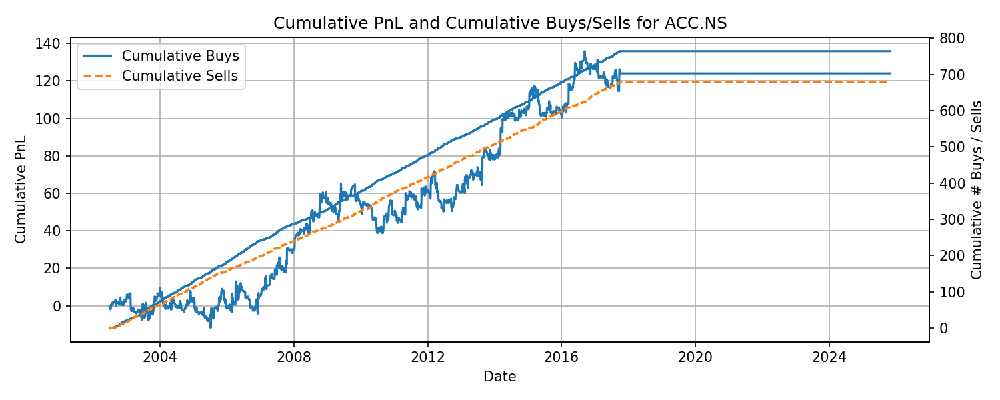

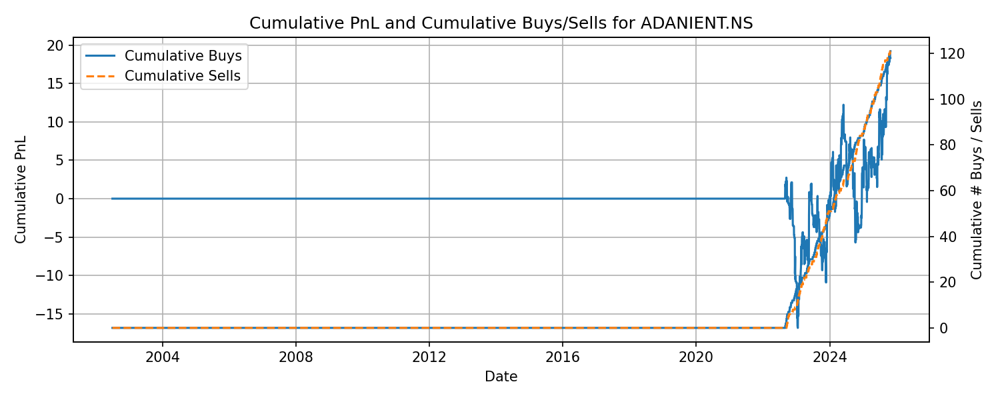

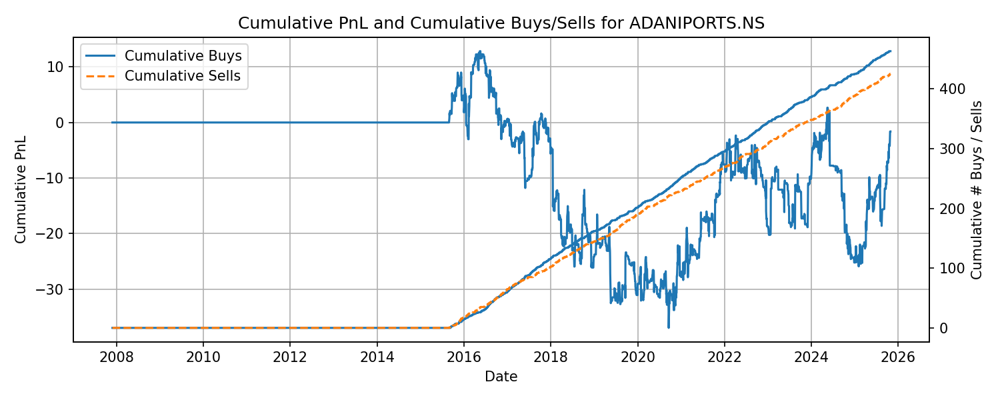

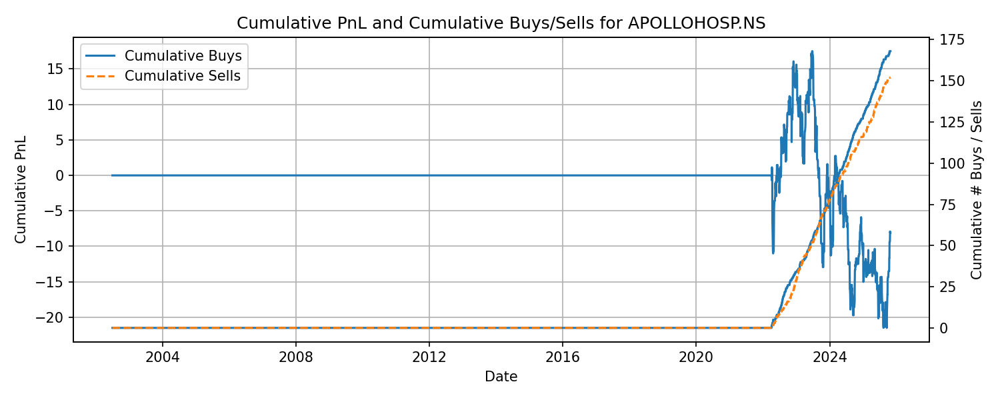

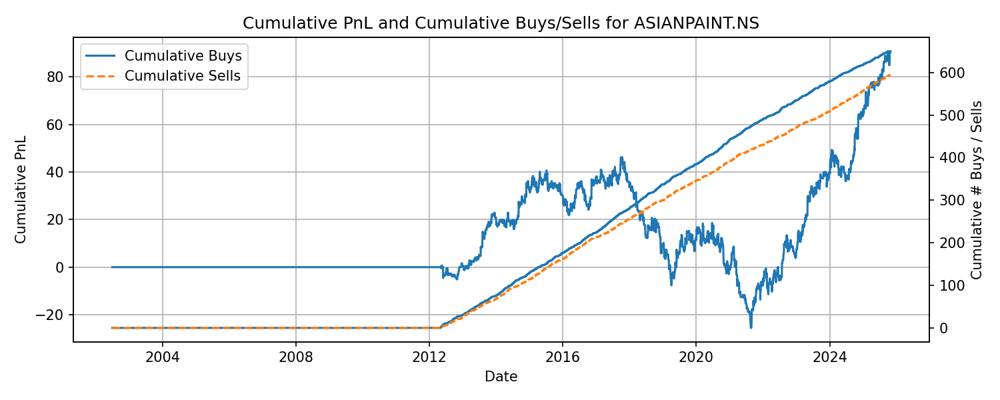

...

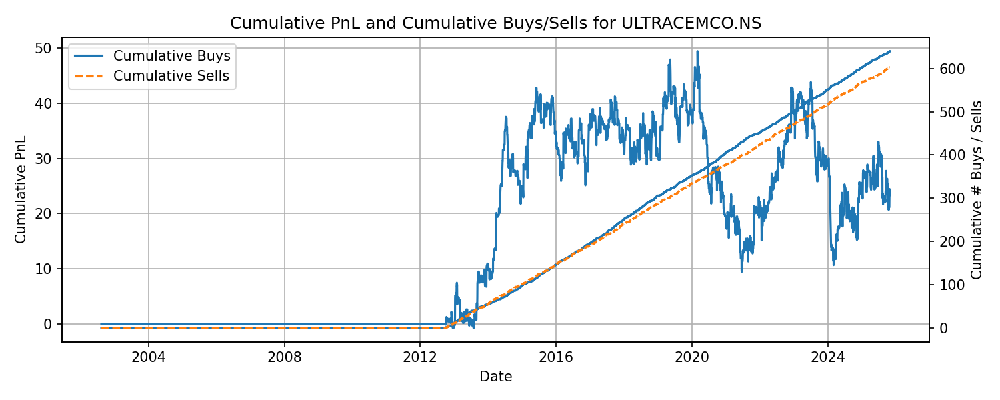

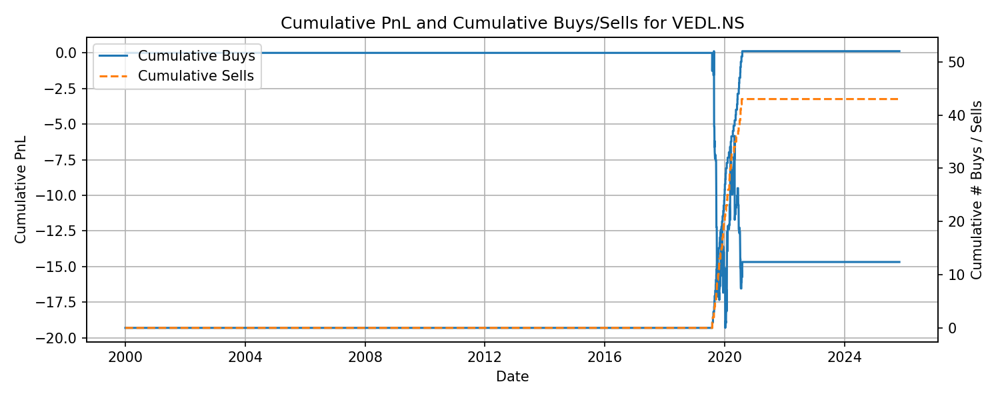

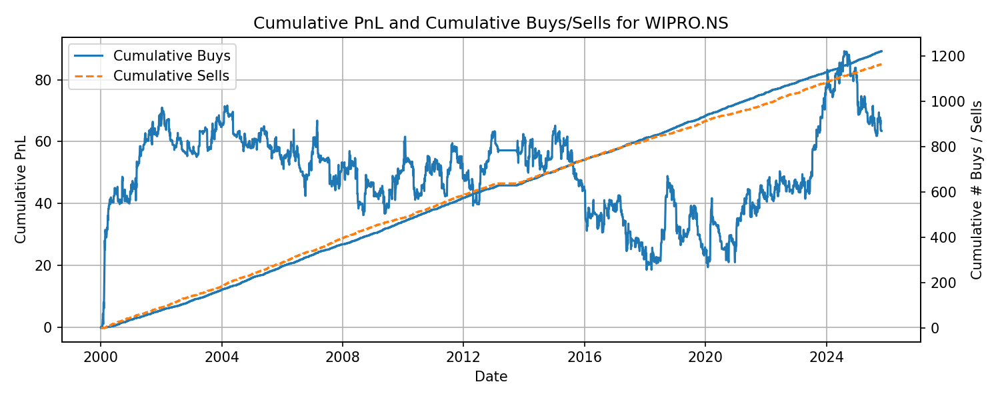

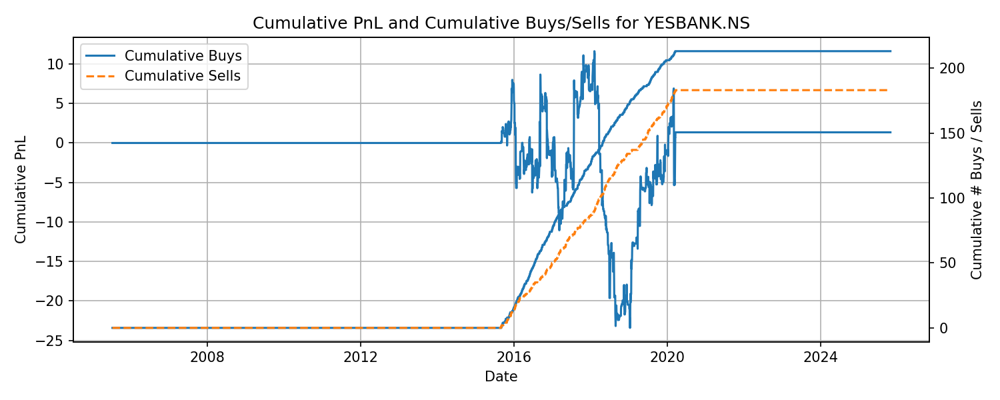

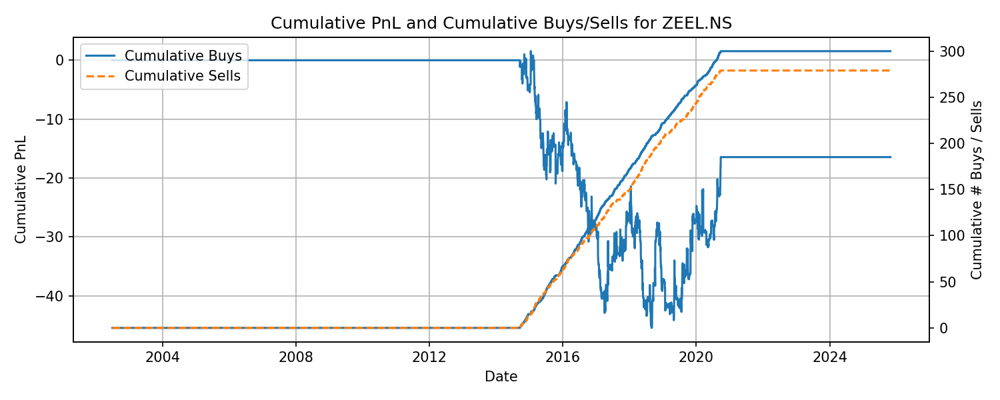

Saved combined plots to: /content/pnl_plots (total 68 files)


In [ ]:
# ---------- First: build and show buy/sell summary table for all tickers ----------
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

N = 20
alpha = (N - 1)/N
threshold = 0.5

summary = {}

for ticker in price_df.columns:
    p = price_df[ticker].dropna()
    if p.empty:
        continue

    f = flag_df[ticker].reindex(p.index).fillna(False).astype(bool)

    # recreate the exact signal you used
    ret = p.diff()
    sigma = ret.rolling(30).std()
    U = ret / sigma
    lower = U.quantile(0.01)
    upper = U.quantile(0.99)
    Uc = U.clip(lower=lower, upper=upper)
    phi_unf = Uc.ewm(alpha=alpha, adjust=False).mean()
    phi_filtered = phi_unf.where(phi_unf.abs() >= threshold, 0.0)

    pos = phi_filtered.fillna(0.0)
    pos_masked = pos.where(f, 0.0)

    is_buy = (pos_masked > 0)
    is_sell = (pos_masked < 0)

    prev_buy = is_buy.shift(1).fillna(False).astype(bool)
    prev_sell = is_sell.shift(1).fillna(False).astype(bool)

    buy_entry = (is_buy & (~prev_buy)).astype(int)
    sell_entry = (is_sell & (~prev_sell)).astype(int)

    total_buys = int(buy_entry.sum())
    total_sells = int(sell_entry.sum())
    long_days = int(is_buy.sum())
    short_days = int(is_sell.sum())
    obs_days = int(f.sum())
    avg_long_hold = (long_days / total_buys) if total_buys > 0 else np.nan
    avg_short_hold = (short_days / total_sells) if total_sells > 0 else np.nan

    summary[ticker] = {
        'Total_Buys': total_buys,
        'Total_Sells': total_sells,
        'Long_Days': long_days,
        'Short_Days': short_days,
        'Avg_Long_Hold_days': round(avg_long_hold, 2) if not np.isnan(avg_long_hold) else np.nan,
        'Avg_Short_Hold_days': round(avg_short_hold, 2) if not np.isnan(avg_short_hold) else np.nan,
        'Obs_Days_in_Nifty': obs_days
    }

counts_df = pd.DataFrame(summary).T.sort_values('Total_Buys', ascending=False)
counts_df.index.name = 'Ticker'

# display and save
from IPython.display import display
print("Buy/Sell summary for all tickers:")
display(counts_df)
counts_df.to_csv(os.path.join(outdir, "buy_sell_summary_all_tickers.csv"))
print(f"Saved summary CSV to: {os.path.join(outdir, 'buy_sell_summary_all_tickers.csv')}")

# ---------- Then: generate combined plots (cumulative PnL + cumulative buys/sells) ----------
plots = []
for ticker in price_df.columns:
    price = price_df[ticker].dropna()
    if price.empty:
        continue

    # flag aligned to price index
    f = flag_df[ticker].reindex(price.index).fillna(False).astype(bool)

    # re-create signal exactly like your loop
    ret = price.diff()
    sigma = ret.rolling(30).std()
    U = ret / sigma
    lower = U.quantile(0.01)
    upper = U.quantile(0.99)
    Uc = U.clip(lower=lower, upper=upper)
    phi_unf = Uc.ewm(alpha=alpha, adjust=False).mean()
    phi_filtered = phi_unf.where(phi_unf.abs() >= threshold, 0.0)

    # position on date t (same as used for pnl)
    pos = phi_filtered.fillna(0.0)
    pos_masked = pos.where(f, 0.0)

    # buy / sell booleans
    is_buy = (pos_masked > 0)
    is_sell = (pos_masked < 0)
    prev_buy = is_buy.shift(1).fillna(False).astype(bool)
    prev_sell = is_sell.shift(1).fillna(False).astype(bool)
    buy_entry = (is_buy & (~prev_buy)).astype(int)
    sell_entry = (is_sell & (~prev_sell)).astype(int)

    # cumulative counts
    cum_buys = buy_entry.cumsum()
    cum_sells = sell_entry.cumsum()

    # cumulative pnl (use the pnl you already computed inside loop)
    pnl_ser = pnl_dict.get(ticker)
    if pnl_ser is None:
        raw_pnl = phi_filtered * U.shift(-1)
        pnl_ser = raw_pnl.where(f, 0.0)
    cum_pnl = pnl_ser.fillna(0.0).cumsum()

    # align the indices and forward-fill for plotting continuity
    idx = cum_pnl.index.union(cum_buys.index).sort_values()
    cum_pnl = cum_pnl.reindex(idx).ffill().fillna(0.0)
    cum_buys = cum_buys.reindex(idx).ffill().fillna(0).astype(int)
    cum_sells = cum_sells.reindex(idx).ffill().fillna(0).astype(int)

    # Plot simple twin-axis figure
    plt.figure(figsize=(10,4))
    ax1 = plt.gca()
    ax1.plot(cum_pnl.index, cum_pnl.values)
    ax1.set_xlabel("Date")
    ax1.set_ylabel("Cumulative PnL")
    ax1.grid(True)

    ax2 = ax1.twinx()
    ax2.step(cum_buys.index, cum_buys.values, where='post', label='Cumulative Buys')
    ax2.step(cum_sells.index, cum_sells.values, where='post', linestyle='--', label='Cumulative Sells')
    ax2.set_ylabel("Cumulative # Buys / Sells")
    ax2.legend(loc='upper left')

    plt.title(f"Cumulative PnL and Cumulative Buys/Sells for {ticker}")
    fname_out = os.path.join(outdir, f"{ticker.replace('/', '_')}_cum_pnl_buysells.png")
    plt.tight_layout()
    plt.savefig(fname_out, dpi=150)
    plt.close()

    plots.append(fname_out)

# ---------- Display same way you were displaying plots ----------
plot_files = sorted([p for p in plots if p.endswith(".png")])
for p in plot_files[:]:
    display(Image(filename=p, width=900))

print(f"Saved combined plots to: {outdir} (total {len(plot_files)} files)")


***Garch start***

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import skew, kurtosis
from arch import arch_model
import warnings
warnings.filterwarnings('ignore')

# Strategy parameters (match your original)
N = 20
alpha = (N - 1) / N
threshold = 0.5

pnl_dict = {}
stats = {}
garch_params = {}

# Prepare output folder for plots
outdir = "/content/pnl_plots"
os.makedirs(outdir, exist_ok=True)

def fit_garch_model(ret_series, p=1, q=1):
    """
    Fit GARCH(p,q) to a return series (ret_series should be raw returns, e.g. price.diff()).
    Returns: (fitted_model or None, conditional_volatility_series aligned to ret_series.index)
    If fitting fails, returns (None, rolling 30-day std fallback).
    """
    try:
        # Convert to percentage for numerical stability as before
        ret_pct = ret_series * 100
        model = arch_model(ret_pct.dropna(), vol='Garch', p=p, q=q, dist='normal')
        fitted = model.fit(disp='off', show_warning=False)
        # fitted.conditional_volatility is in same units as ret_pct (percent)
        cond_vol = pd.Series(index=ret_pct.dropna().index, data=fitted.conditional_volatility) / 100.0
        # Reindex to original ret_series index (NaN where model couldn't produce)
        cond_vol = cond_vol.reindex(ret_series.index)
        return fitted, cond_vol
    except Exception as e:
        # fallback rolling 30-day std (align index)
        fallback = ret_series.rolling(30).std()
        return None, fallback

for ticker in price_df.columns:
    price = price_df[ticker].dropna()
    if price.empty:
        continue

    # Align flag to price index (no phi masking here)
    f = flag_df[ticker].reindex(price.index).fillna(False).astype(bool)

    # compute simple returns (same as original)
    ret = price.diff()

    # Fit GARCH on returns; get conditional vol aligned to ret index
    garch_model, garch_vol = fit_garch_model(ret)

    # store garch params if successful (optional)
    if garch_model is not None:
        try:
            garch_params[ticker] = {
                'omega': garch_model.params.get('omega', np.nan),
                'alpha[1]': garch_model.params.get('alpha[1]', np.nan),
                'beta[1]': garch_model.params.get('beta[1]', np.nan),
                'loglikelihood': getattr(garch_model, 'loglikelihood', np.nan),
                'aic': getattr(garch_model, 'aic', np.nan),
                'bic': getattr(garch_model, 'bic', np.nan)
            }
        except Exception:
            pass

    # Use GARCH volatility where available, otherwise fallback given by fit_garch_model
    sigma = garch_vol

    # Avoid division by zero: where sigma is 0 or NaN leave U as NaN
    sigma = sigma.replace(0, np.nan)

    # Standardized return
    U = ret / sigma

    # clip extremes (same order as original)
    lower = U.quantile(0.01)
    upper = U.quantile(0.99)
    U = U.clip(lower=lower, upper=upper)

    # compute EWMA phi across entire series (even when not in nifty)
    phi_unf = U.ewm(alpha=alpha, adjust=False).mean()
    phi_filtered = phi_unf.where(np.abs(phi_unf) >= threshold, 0.0)

    # compute raw pnl and force it to zero when flag is False
    # use U.shift(-1) to apply today's signal to next-period return (no lookahead)
    raw_pnl = phi_filtered * U.shift(-1)
    pnl = raw_pnl.where(f, 0.0)

    # store series (including its datetime index)
    pnl_dict[ticker] = pnl

    # compute stats on pnl (dropna to ignore NaN from edges)
    s = pnl.dropna()
    stats[ticker] = {
        'Mean': s.mean() if not s.empty else np.nan,
        'Variance': s.var() if not s.empty else np.nan,
        'Skewness': skew(s) if not s.empty else np.nan,
        'Kurtosis': kurtosis(s) if not s.empty else np.nan,
    }

    # --- Plot cumulative PnL for this ticker ---
    cum_pnl = pnl.fillna(0).cumsum()  # treat NaN as 0 for plotting continuity

    plt.figure(figsize=(10, 4))
    plt.plot(cum_pnl.index, cum_pnl.values)  # do not set colors explicitly
    plt.title(f"Cumulative PnL for {ticker}")
    plt.xlabel("Date")
    plt.ylabel("Cumulative PnL")
    plt.grid(True)
    # save plot
    fname_out = os.path.join(outdir, f"{ticker.replace('/', '_')}_cum_pnl.png")
    plt.tight_layout()
    plt.savefig(fname_out, dpi=150)
    plt.close()

# Convert to DataFrames and save results (optional)
pnl_df = pd.DataFrame(pnl_dict)
stats_df = pd.DataFrame(stats).T
garch_params_df = pd.DataFrame(garch_params).T if garch_params else pd.DataFrame()

pnl_df.to_csv("nifty50_pnl_garch_aligned.csv")
stats_df.to_csv("nifty50_pnl_statistics_garch_aligned.csv")
if not garch_params_df.empty:
    garch_params_df.to_csv("garch_model_parameters_aligned.csv")


In [ ]:
!pip install arch

Date range used: 2000-01-03 00:00:00+05:30 to 2025-10-27 00:00:00+05:30
Tickers used: 68
                   Mean  Variance   Skewness    Kurtosis
POWERGRID.NS  -0.029639  0.851503   0.322870   10.258081
CIPLA.NS      -0.024367  0.493401  -0.511385   15.759148
JSWSTEEL.NS   -0.019891  0.289173  -0.782384   37.013551
HDFCLIFE.NS   -0.015811  0.486668  -1.086546   14.363337
KOTAKBANK.NS  -0.014345  0.479302  -0.095770   18.082668
SBILIFE.NS    -0.012849  0.560098   0.150858   16.914467
NTPC.NS       -0.012719  0.760962   0.540644   10.931414
BHARTIARTL.NS -0.012713  0.983419   0.541037   15.129491
TATACONSUM.NS -0.007324  0.145377  -0.132511   95.750000
SUNPHARMA.NS  -0.007158  1.066683   0.052960   13.963564
ITC.NS        -0.006978  0.894620   0.087888   11.152827
NESTLEIND.NS  -0.005274  0.246989   0.084154   26.856799
ZEEL.NS       -0.002840  0.264536   1.357950   51.378290
HCLTECH.NS    -0.002671  0.877375   0.538601   10.059110
VEDL.NS       -0.002279  0.031949  -6.677154  414.083446

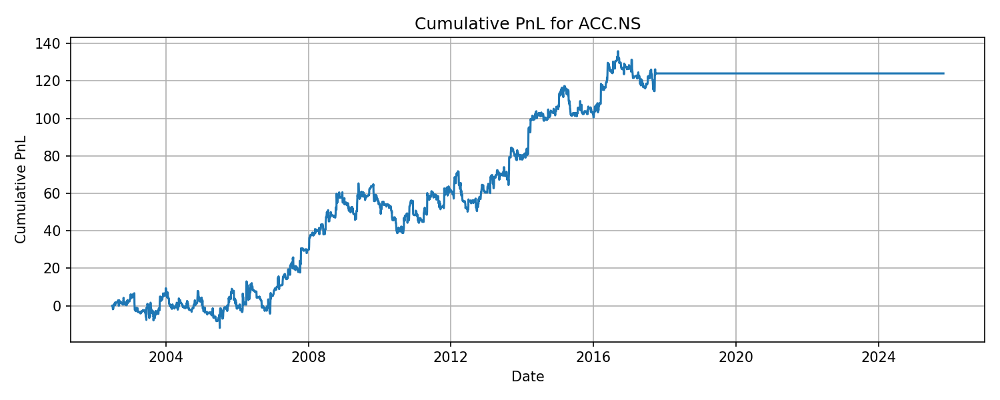

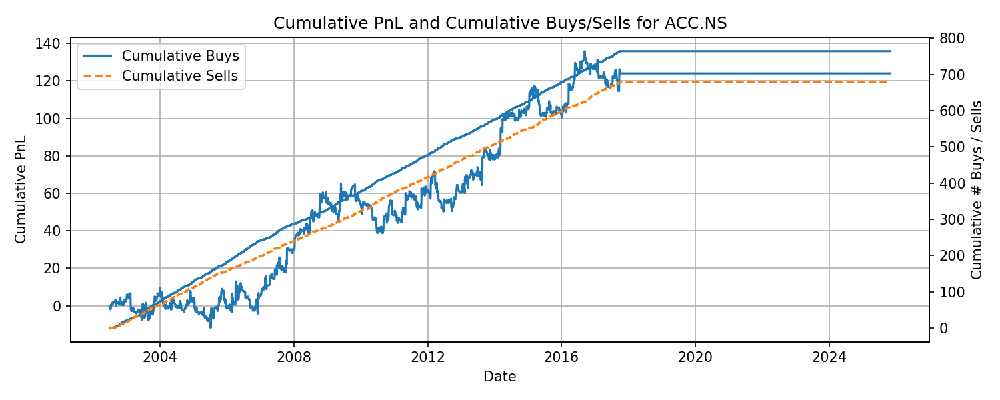

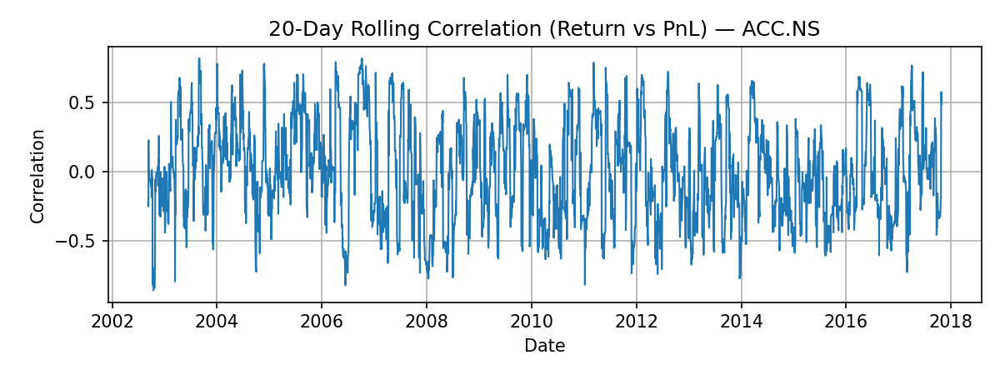

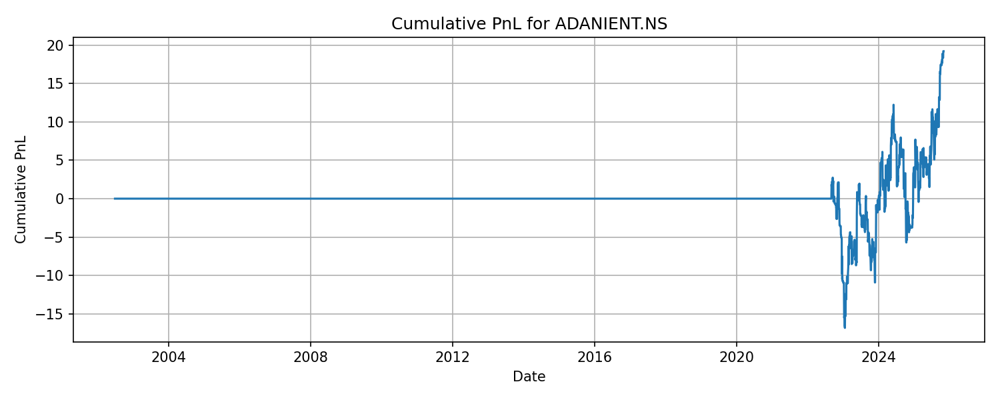

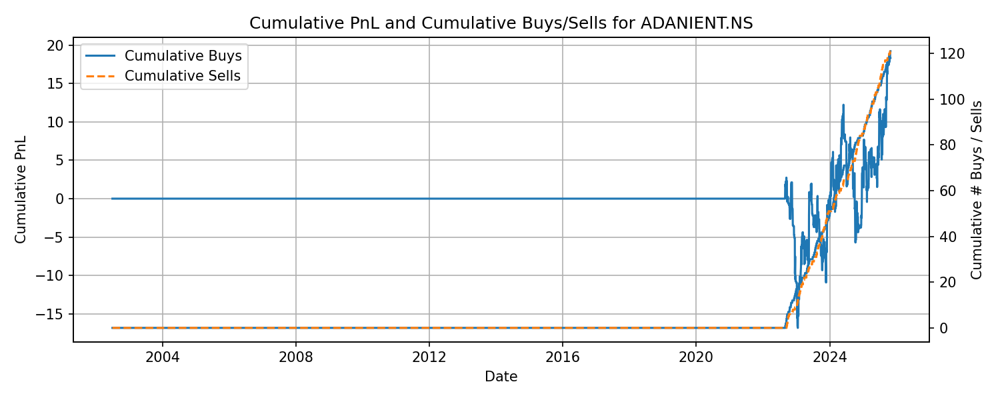

...

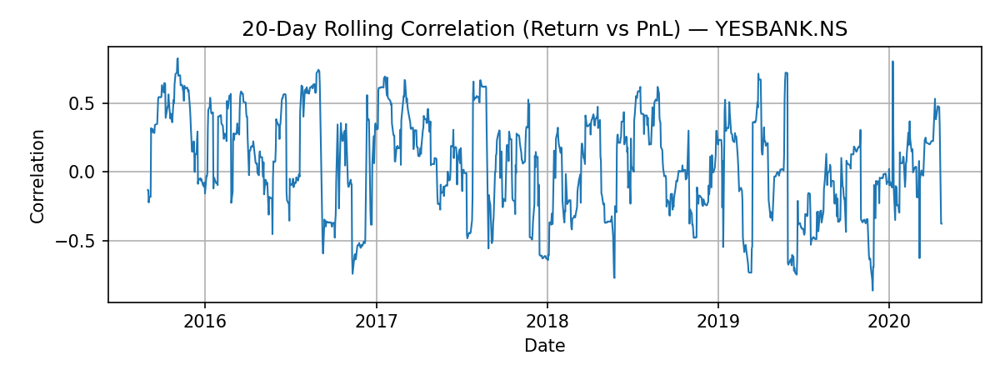

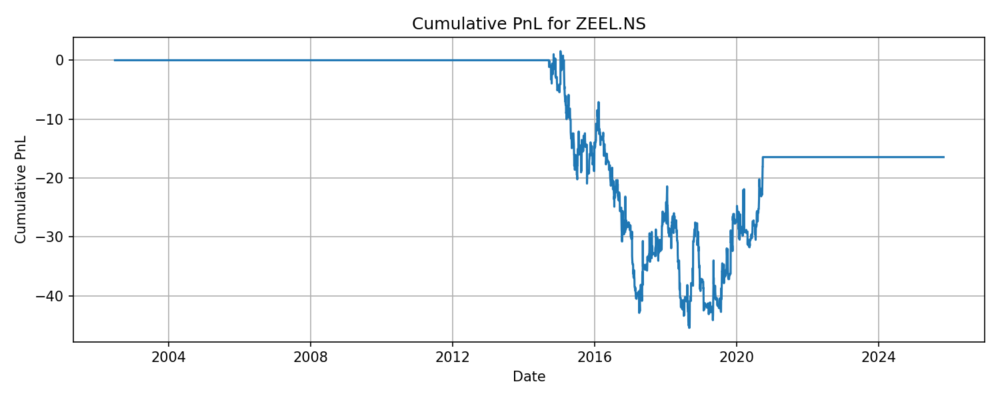

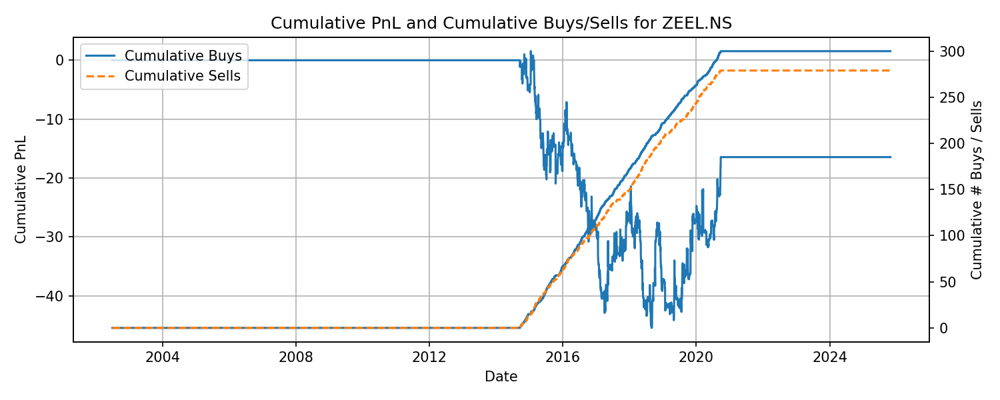

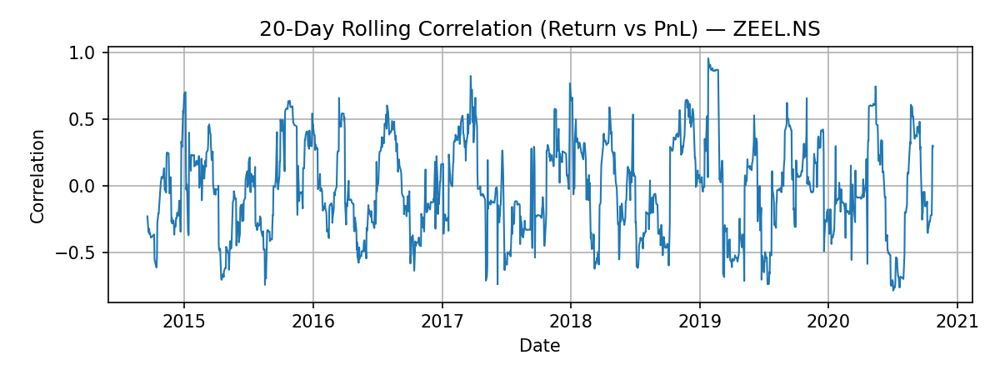

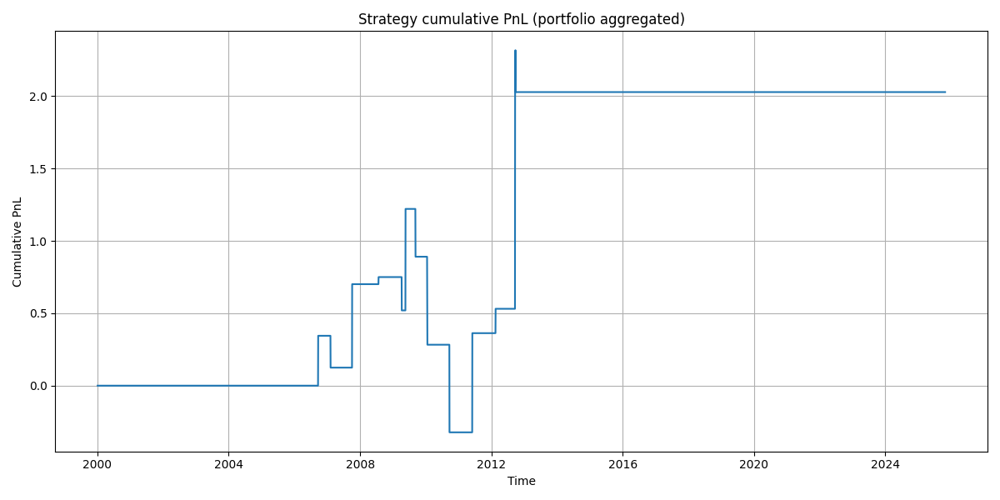

All plots saved to: /content/pnl_plots (total 205 png files)


In [ ]:
# --- Convert to DataFrames and display summary ---
pnl_df = pd.DataFrame(pnl_dict)
stats_df = pd.DataFrame(stats).T

print("Date range used:", price_df.index.min(), "to", price_df.index.max())
print("Tickers used:", len(pnl_df.columns))
print(stats_df.sort_values("Mean", ascending=True).head(50))

# --- Show all generated PnL plots inline (same style as before) ---
from IPython.display import display, Image
plot_files = sorted([os.path.join(outdir, f) for f in os.listdir(outdir) if f.endswith(".png")])

for p in plot_files[:]:  # show first 6 for quick inspection
    display(Image(filename=p, width=900))

print(f"All plots saved to: {outdir} (total {len(plot_files)} png files)")


In [ ]:
# KERAS LSTM STRATEGY (uses price_df & flag_df if present; otherwise falls back to `data`)
# COPY-PASTE THIS WHOLE CELL
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import skew
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.callbacks import EarlyStopping

# ---------- USER-TUNABLE PARAMS ----------
lookback = 40
threshold = 0.05
epochs = 20
batch_size = 32
lstm_units = 50
dense_units = 25
test_fraction = 0.2

outdir = "./pnl_plots_keras"
os.makedirs(outdir, exist_ok=True)
ticker_plot_dir = os.path.join(outdir, "ticker_plots")
os.makedirs(ticker_plot_dir, exist_ok=True)

# ---------- Pick input DataFrame ----------
# Prefer price_df (your existing variable). If not present, fall back to `data`.
if 'price_df' in globals():
    source_df = price_df
    print("Using price_df as input.")
elif 'data' in globals():
    source_df = data
    print("Using data as input.")
else:
    raise RuntimeError("Neither 'price_df' nor 'data' found in the environment. Please load your price DataFrame as price_df or data.")

# flag_df should exist (if you used it before). If not found, create permissive flag (all True).
if 'flag_df' not in globals():
    print("flag_df not found — creating permissive flag (all True) aligned to source_df).")
    flag_df = source_df.notna().astype(bool)

# ---------- helpers ----------
def create_XY(series, lookback):
    X, Y = [], []
    for i in range(lookback, len(series)):
        X.append(series.values[i-lookback:i])
        Y.append(series.values[i])
    if len(X) == 0:
        return np.zeros((0, lookback, 1)), np.zeros((0,))
    X = np.array(X).reshape(-1, lookback, 1).astype(np.float32)
    Y = np.array(Y).astype(np.float32)
    return X, Y

def safe_plot_save(fig, path):
    try:
        fig.savefig(path)
    except Exception as e:
        print("Warning: could not save plot", path, e)
    finally:
        plt.close(fig)

# ---------- storage ----------
results_pnl = {}
equity_curves = {}
summary_rows = []

# ---------- main loop ----------
tickers = list(source_df.columns)
print(f"Tickers to process: {len(tickers)}")

for ticker in tickers:
    print(f"\n=== Processing {ticker} ===")
    # align price series
    price = source_df[ticker].dropna()
    if price.shape[0] < (lookback + 10):
        print(f"  Skipping {ticker}: not enough price rows ({price.shape[0]}).")
        continue

    # compute U = return / volatility (EWMA std)
    ret = price.diff()
    sigma = ret.ewm(span=lookback, adjust=False).std()
    U = (ret / sigma).replace([np.inf, -np.inf], np.nan).dropna()
    if U.shape[0] < (lookback + 5):
        print(f"  Skipping {ticker}: not enough non-NaN U values ({U.shape[0]}).")
        continue

    # winsorize (safe)
    lower = U.quantile(0.01)
    upper = U.quantile(0.99)
    U = U.clip(lower=lower, upper=upper)

    # train/test split
    split = int((1 - test_fraction) * len(U))
    if split <= lookback or split >= len(U)-1:
        print(f"  Skipping {ticker}: bad split (split={split}, len(U)={len(U)}).")
        continue

    train_series = U.iloc[:split]
    test_series = U.iloc[split:]

    X_train, y_train = create_XY(train_series, lookback)
    X_test, y_test = create_XY(test_series, lookback)
    if X_test.shape[0] == 0:
        print(f"  Skipping {ticker}: no test windows after lookback.")
        continue
    test_index = test_series.index[lookback:]

    # Model
    model = Sequential([
        LSTM(lstm_units, input_shape=(lookback, 1)),
        Dense(dense_units, activation='relu'),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    es = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True, verbose=0)

    try:
        model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0, callbacks=[es])
    except Exception as e:
        print(f"  Training failed for {ticker}: {e}")
        continue

    # Predictions on test set
    pred_U = model.predict(X_test, verbose=0).flatten()
    pred_series = pd.Series(pred_U, index=test_index)

    # Signal: thresholded sign
    signal = pd.Series(np.where(np.abs(pred_series) >= threshold, np.sign(pred_series), 0.0), index=test_index)

    # Force PnL = 0 when flag is False (align flag to test_index)
    f = flag_df.reindex(index=test_index, columns=[ticker])[ticker].fillna(False).astype(bool)

    actual_U = pd.Series(y_test, index=test_index)
    raw_pnl = signal * actual_U
    pnl = raw_pnl.where(f, 0.0)

    # Save results
    results_pnl[ticker] = pnl
    equity_curve = (1.0 + pnl).cumprod().fillna(method='ffill').fillna(1.0)
    equity_curves[ticker] = equity_curve

    # Stats and counts
    s = pnl.dropna()
    mean_p = float(s.mean()) if not s.empty else 0.0
    var_p = float(s.var()) if not s.empty else 0.0
    skew_p = float(skew(s)) if len(s) > 2 else np.nan

    buys_sig = int((signal > 0).sum())
    sells_sig = int((signal < 0).sum())
    neutrals = int((signal == 0).sum())

    sign_arr = np.sign(signal.values)
    prev = np.concatenate(([0.0], sign_arr[:-1]))
    buy_entries = int(((prev <= 0) & (sign_arr > 0)).sum())
    sell_entries = int(((prev >= 0) & (sign_arr < 0)).sum())

    summary_rows.append({
        'Ticker': ticker,
        'Mean': mean_p,
        'Variance': var_p,
        'Skewness': skew_p,
        'Count': int(s.shape[0]) if not s.empty else 0,
        'Buys_SignalCounts': buys_sig,
        'Sells_SignalCounts': sells_sig,
        'Neutrals': neutrals,
        'Buy_Entries': buy_entries,
        'Sell_Entries': sell_entries
    })

    # Save plots per ticker
    try:
        fig = plt.figure(figsize=(10,4))
        plt.plot(equity_curve.index, equity_curve.values, label=f"{ticker} Equity")
        plt.title(f"{ticker} Equity Curve")
        plt.xlabel("Time")
        plt.ylabel("Equity")
        plt.grid(True)
        plt.legend()
        safe_plot_save(fig, os.path.join(ticker_plot_dir, f"{ticker}_equity.png"))

        fig, axs = plt.subplots(3,1,figsize=(12,8), sharex=True, gridspec_kw={'height_ratios':[2,1,1]})
        axs[0].plot(pred_series.index, pred_series.values, label='pred_U')
        axs[0].axhline(threshold, linestyle='--', label=f'+{threshold}')
        axs[0].axhline(-threshold, linestyle='--', label=f'-{threshold}')
        axs[0].set_title(f"{ticker} predicted U (test)")
        axs[0].legend()

        axs[1].step(signal.index, signal.values, where='post')
        axs[1].set_title("Thresholded signal (pos=buy, neg=sell)")

        axs[2].plot(pnl.index, pnl.cumsum().values)
        axs[2].set_title("Cumulative pnl (ticker)")

        plt.tight_layout()
        safe_plot_save(fig, os.path.join(ticker_plot_dir, f"{ticker}_signal_pnl.png"))
    except Exception as e:
        print("  Plot warning for", ticker, e)

print("\nPer-ticker processing finished.")

# ---------- Portfolio aggregation ----------
if len(results_pnl) == 0:
    raise RuntimeError("No results produced. Check your input DataFrame and parameters.")

pnl_df = pd.DataFrame(results_pnl)  # columns = tickers
portfolio_pnl = pnl_df.fillna(0.0).sum(axis=1)
# portfolio equity as cumulative product (starting at 1)
portfolio_cum = (1.0 + portfolio_pnl).cumprod()

# Save portfolio plot
plt.figure(figsize=(12,5))
plt.plot(portfolio_cum.index, portfolio_cum.values, label="Portfolio equity")
plt.title("Portfolio cumulative equity (Keras LSTM strategy)")
plt.xlabel("Time")
plt.ylabel("Portfolio equity")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.savefig(os.path.join(outdir, "portfolio_equity.png"))
plt.close()

# Save summary CSV
summary_df = pd.DataFrame(summary_rows).set_index('Ticker').sort_values('Mean', ascending=False)
summary_csv = os.path.join(outdir, "per_ticker_summary_keras.csv")
summary_df.to_csv(summary_csv)

print("Saved per-ticker plots to:", ticker_plot_dir)
print("Saved portfolio plot to:", os.path.join(outdir, "portfolio_equity.png"))
print("Saved per-ticker summary CSV to:", summary_csv)

# Expose main objects (available in notebook namespace)
# pnl_df, equity_curves, portfolio_pnl, portfolio_cum, summary_df


Using price_df as input.
Tickers to process: 68

=== Processing ACC.NS ===

=== Processing ADANIENT.NS ===

=== Processing ADANIPORTS.NS ===

=== Processing APOLLOHOSP.NS ===

=== Processing ASIANPAINT.NS ===

=== Processing AXISBANK.NS ===

=== Processing BAJAJ-AUTO.NS ===

=== Processing BAJAJFINSV.NS ===

=== Processing BAJFINANCE.NS ===

=== Processing BANKBARODA.NS ===

=== Processing BEL.NS ===

=== Processing BHARTIARTL.NS ===

=== Processing BHEL.NS ===

=== Processing BOSCHLTD.NS ===

=== Processing BPCL.NS ===

=== Processing BRITANNIA.NS ===

=== Processing CIPLA.NS ===

=== Processing COALINDIA.NS ===

=== Processing DLF.NS ===

=== Processing DRREDDY.NS ===

=== Processing EICHERMOT.NS ===

=== Processing GAIL.NS ===

=== Processing GRASIM.NS ===

=== Processing HCLTECH.NS ===

=== Processing HDFCBANK.NS ===

=== Processing HDFCLIFE.NS ===

=== Processing HEROMOTOCO.NS ===

=== Processing HINDALCO.NS ===

=== Processing HINDUNILVR.NS ===

=== Processing HINDZINC.NS ===

==